In [10]:
# import libraries
import altair as alt
import pandas as pd
import numpy as np

# it just needs to be here so we can work with big files 
alt.data_transformers.enable('default', max_rows=None)
alt.renderers.enable('notebook')

RendererRegistry.enable('notebook')

In [11]:
# data uploading
df = pd.read_csv('https://gist.githubusercontent.com/andriy-gazin/f8f74625aeb3602850067fbb47bc1e4f/raw/05e5080840396deb084e90208dc8e76a75a980a3/pitchfork.csv')
df.head()

,artist,album,genre,primary,score,date,author,role
0,David Byrne,“…The Best Live Show of All Time” — NME EP,Rock,Rock,5.5,2019-01-11,Andy Beta,Contributor
1,DJ Healer,Lost Lovesongs / Lostsongs Vol. 2,Electronic,Electronic,6.2,2019-01-11,Chal Ravens,Contributor
2,Jorge Velez,Roman Birds,Electronic,Electronic,7.9,2019-01-10,Philip Sherburne,Contributing Editor
3,Chandra,Transportation EPs,Rock,Rock,7.8,2019-01-10,Andy Beta,Contributor
4,The Chainsmokers,Sick Boy,Electronic,Electronic,3.1,2019-01-09,Larry Fitzmaurice,Contributor


# HW3 - Data Exploration

- Relation between number of reviews and average score by primary genre and year
- 10 best bands/artists by score
- Number / distribution of reviews with score equals or above 8 by primary genre
- Number / distribution of reviews with score equals or below 2 by primary genre
- Genre's rank (by number of reviews) and it's number of reviews by year

## Relation between number of reviews and average score by primary genre and year

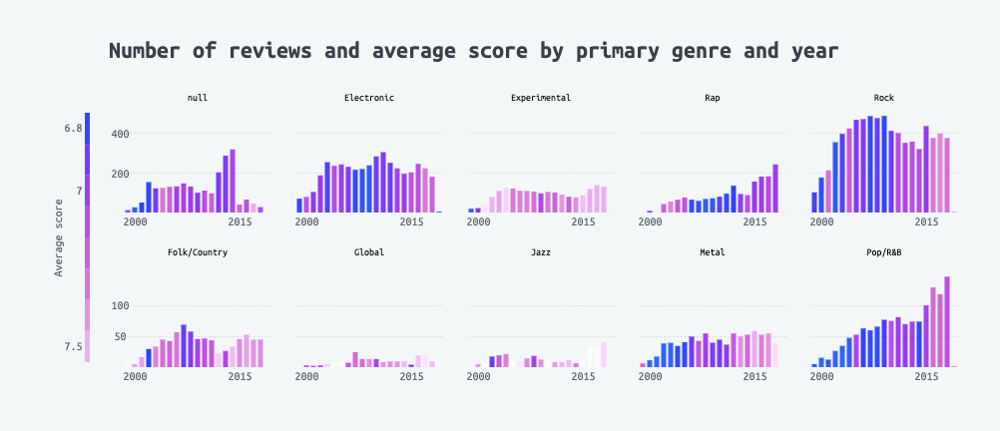

In [12]:
# configurations
background = '#F3F7F7'
font = 'Ubuntu Mono'
title_color, title_size = '#3A3F4A', 36
text_color, text_size = '#5D646F', 12
color_scale = ['#7e0cf5', '#cd4dcc', '#f7beff']

# configure colors
temp = df.groupby('primary').mean()
domain = [temp.score.min(), temp.score.quantile(0.75)-0.1, temp.score.max()]
domain.reverse()
color_scale.reverse()
range_ = color_scale
# customized legend + subtitle
ax = alt.Axis(values = [6.8, 7, int(temp.score.max()*10)/10],
                 grid=False, 
                 domain=False, 
                 ticks=False,
                 labelAngle = 0,
                 labelColor = text_color,
                 labelFontSize = text_size,
                 labelFont = font,
                 labelPadding = 3,
                 position = 0,
                 titleFontSize = text_size,     #subtitle
                 titleFontWeight = 'lighter',
                 titleColor = text_color,
                 titlePadding = 0,
                 titleFont = font,
                 titleAngle = 270,
                 titleAnchor = 'middle',
                 )

# custom legend
temp_df = pd.DataFrame({'range':[i/10 for i in range(int(temp.score.min()*10)-1, int(temp.score.max()*10)+1)]})

legend = alt.Chart(temp_df).mark_rect(opacity = 0.8).encode(
    y = alt.Y('range:N', title = 'Average score', axis = ax),
    color = alt.Color('range:Q', legend= None, scale=alt.Scale(domain=domain, range=range_)),
).properties(height=250, width = 5)

# axes
axisX = alt.Axis(values = [2000,2015],
                 grid=False, 
                 domain=False, 
                 ticks=False,
                 labelAngle =0,
                 labelColor = text_color,
                 labelFontSize = text_size,
                 labelFont = font,
#                  labelPadding = -height-14,
                 )

axisY1= alt.Axis(values = [200,400],
                 grid=True, 
                 gridDash = [0,2,0],
                 domain=False, 
                 ticks=False,
                 labelAngle =0,
                 labelColor = text_color,
                 labelFontSize = text_size,
                 labelFont = font,
                 labelAlign = 'center',
                 titleFont = font,
                 titleFontSize = text_size,
                 titleColor = text_color,
                 )
axisY2= alt.Axis(values = [50,100],
                 grid=True, 
                 gridDash = [0,2,0],
                 domain=False, 
                 ticks=False,
                 labelAngle =0,
                 labelColor = text_color,
                 labelFontSize = text_size,
                 labelFont = font,
                 labelAlign = 'center',
                 titleFont = font,
                 titleFontSize = text_size,
                 titleColor = text_color,
                 )

columns_order = df.groupby('primary').count().sort_values(by = 'date', ascending = False).index
a = ['Rock', 'Electronic', 'Experimental', 'Rap', df.primary.unique()[-4]]
b = ['Metal', 'Folk/Country', 'Jazz', 'Global', 'Pop/R&B']

chart1 = alt.Chart(df[df.primary.isin(a)]).mark_bar(opacity = 0.8).encode(
    x = alt.X('date:T', title = None, timeUnit='year', axis = axisX,),
    y = alt.Y('count()', title = None, axis = axisY1), #title = 'Number of reviews'
    facet = alt.Facet('primary', title = None, header = alt.Header(titleFont = font, labelFont = font)),
    color = alt.Color('mean(score)', legend= None, scale=alt.Scale(domain=domain, range=range_, padding=0)),
    tooltip = alt.Tooltip(['mean(score)', 'count()'])
).properties(width = 700).properties(width = 150, height = 100)

chart2 = alt.Chart(df[df.primary.isin(b)]).mark_bar(opacity = 0.8).encode(
    x = alt.X('date:T', title = None, timeUnit='year', axis = axisX,),
    y = alt.Y('count()', title = None, axis = axisY2), #title = 'Number of reviews'
    facet = alt.Facet('primary', title = None, header = alt.Header(titleFont = font, labelFont = font)),
    color = alt.Color('mean(score)', legend= None, scale=alt.Scale(domain=domain, range=range_, padding=0)),
    tooltip = alt.Tooltip(['mean(score)', 'count()'])
).properties(width = 700).properties(width = 150, height = 100)

# title
title_text = 'Number of reviews and average score by primary genre and year'
text_df_footer = pd.DataFrame({'text':[title_text]})
title = alt.Chart(text_df_footer).mark_text(fontWeight = 600, fontSize=24, font=font, color = title_color,align = 'center' ,dx = -10).encode(
    text='text').properties(width=800, height=40)


chart = title&(legend|(chart1&chart2))
chart.configure(background=background, text = alt.TextConfig(font=font),
                padding={"left": 50, "top": 30, "right": 40, "bottom": 50}
).configure_view(
    stroke='transparent'
)

## 10 best bands/artists by score

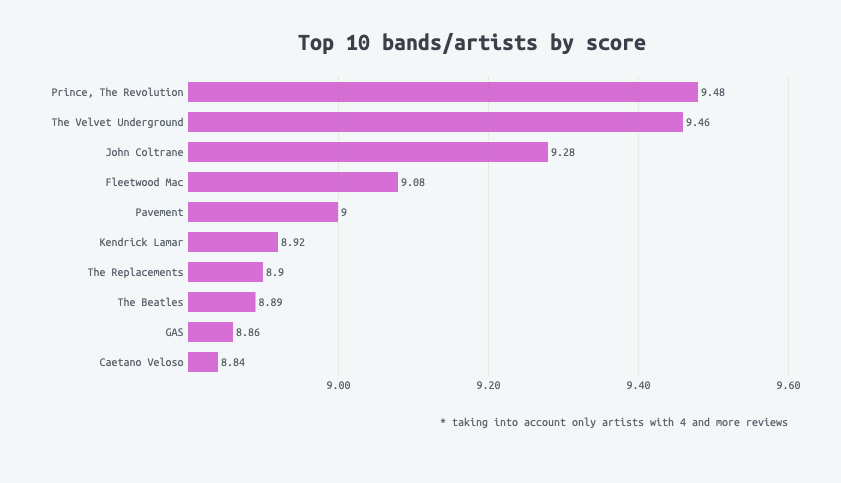

In [13]:
# axes
axisY = alt.Axis(grid=False, 
                 domain=False, 
                 ticks=False,
                 labelAngle = 0,
                 labelColor = text_color,
                 labelFontSize = text_size,
                 labelFont = font,
                 labelPadding = 5,
                 )

# axes
axisX = alt.Axis(values = [9,9.2,9.4,9.6],
                grid=True, 
                 gridDash = [0,2,0],
                 domain=False, 
                 ticks=False,
                 labelAngle =0,
                 labelColor = text_color,
                 labelFontSize = text_size,
                 labelFont = font,
                 )

# preaggregating make altair plots lighter, so it seems like better approuch then filtering
# selecting only artists with 4 and more reviews
a = df.groupby('artist').count()
artists = a[a.album>3].index
df_to_plot = df[df.artist.isin(artists)].groupby('artist').mean().sort_values(by='score', ascending = False).head(10)
df_to_plot['artist'] = df_to_plot.index
df_to_plot['score'] = round(df_to_plot['score'],2)

chart = alt.Chart(df_to_plot).mark_bar(height = 20, color = color_scale[1], opacity = 0.8).encode(
    y = alt.Y('artist', title = None, sort = alt.Sort(field = 'score', order='descending'), axis = axisY),
    x = alt.X('score', title = None, scale=alt.Scale(zero=False, domain = (8.8,9.6)), axis = axisX)
).properties(width = 600, height = 300)

text = chart.mark_text(
    font= font,
    align='left',
    baseline='middle',
    color = text_color,
    size = text_size,
    dx=3  # Nudges text to right so it doesn't appear on top of the bar
).encode(
    text='score:Q'
)

chart = chart+text

# title
title_text = 'Top 10 bands/artists by score '
text_df_footer = pd.DataFrame({'text':[title_text]})
title = alt.Chart(text_df_footer).mark_text(fontWeight = 600, fontSize=24, font=font, color = title_color,align = 'center' ,dx = -10).encode(
    text='text').properties(width=600, height=20)

# footer
text_df_footer = pd.DataFrame({'text':['* taking into account only artists with 4 and more reviews']})
footer = alt.Chart(text_df_footer).mark_text(fontSize=text_size, font=font, color = text_color, dx = 600/2, align = 'right').encode(
    text='text').properties(width=600, height=20)

chart = title&chart&footer

chart.configure(background=background, text = alt.TextConfig(font=font),
                padding={"left": 50, "top": 30, "right": 40, "bottom": 50}
).configure_view(
    stroke='transparent'
)

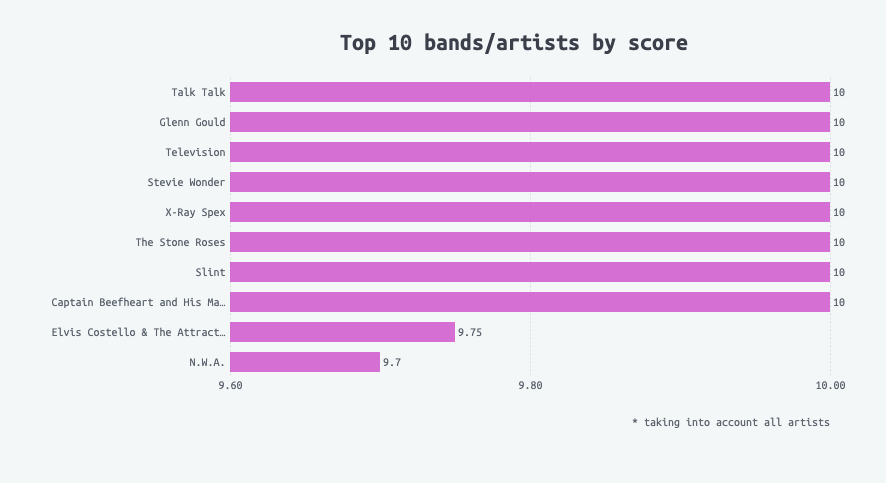

In [14]:
axisX = alt.Axis(values = [9.6,9.8,10],
                grid=True, 
                 gridDash = [0,2,0],
                 domain=False, 
                 ticks=False,
                 labelAngle =0,
                 labelColor = text_color,
                 labelFontSize = text_size,
                 labelFont = font,
                 )

# preaggregating make altair plots lighter, so it seems like better approuch then filtering
# selecting only artists with 4 and more reviews
a = df.groupby('artist').count()
artists = a.index
df_to_plot = df[df.artist.isin(artists)].groupby('artist').mean().sort_values(by='score', ascending = False).head(10)
df_to_plot['artist'] = df_to_plot.index
df_to_plot['score'] = round(df_to_plot['score'],2)

chart = alt.Chart(df_to_plot).mark_bar(height = 20, color = color_scale[1], opacity = 0.8).encode(
    y = alt.Y('artist', title = None, sort = alt.Sort(field = 'score', order='descending'), axis = axisY),
    x = alt.X('score', title = None, scale=alt.Scale(zero=False, domain = (9.6,10)), axis = axisX)
).properties(width = 600, height = 300)

text = chart.mark_text(
    font= font,
    align='left',
    baseline='middle',
    color = text_color,
    size = text_size,
    dx=3  # Nudges text to right so it doesn't appear on top of the bar
).encode(
    text='score:Q'
)

chart = chart+text

# title
title_text = 'Top 10 bands/artists by score '
text_df_footer = pd.DataFrame({'text':[title_text]})
title = alt.Chart(text_df_footer).mark_text(fontWeight = 600, fontSize=24, font=font, color = title_color,align = 'center' ,dx = -10).encode(
    text='text').properties(width=600, height=20)

# footer
text_df_footer = pd.DataFrame({'text':['* taking into account all artists']})
footer = alt.Chart(text_df_footer).mark_text(fontSize=text_size, font=font, color = text_color, dx = 600/2, align = 'right').encode(
    text='text').properties(width=600, height=20)

chart = title&chart&footer

chart.configure(background=background, text = alt.TextConfig(font=font),
                padding={"left": 50, "top": 30, "right": 40, "bottom": 50}
).configure_view(
    stroke='transparent'
)

## Number / distribution of reviews with score equals or above 8 by primary genre

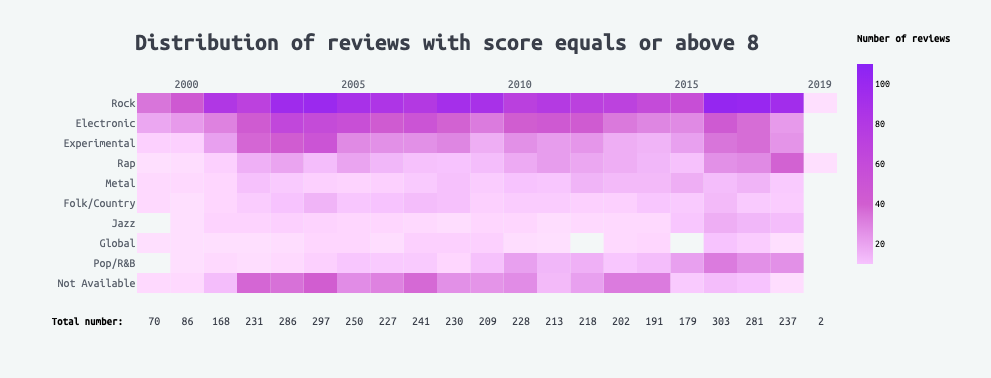

In [15]:
# title
title_text = 'Distribution of reviews with score equals or above 8'
text_df_footer = pd.DataFrame({'text':[title_text]})
title = alt.Chart(text_df_footer).mark_text(fontWeight = 600, fontSize=24, font=font, color = title_color,align = 'center' ,dx = 10).encode(
    text='text').properties(width=600, height=20)

# axes
df.fillna('Not Available', inplace = True)
a = ['Rock', 'Electronic', 'Experimental', 'Rap', 'Metal', 'Folk/Country', 'Jazz', 'Global', 'Pop/R&B', 'Not Available']

axisY = alt.Axis(grid=False, 
                 domain=False, 
                 ticks=False,
                 labelAngle = 0,
                 labelColor = text_color,
                 labelFontSize = text_size,
                 labelFont = font,
                 )

# axes
axisX = alt.Axis(values = [2000,2005,2010,2015,2019],
                grid=False, 
                 domain=False, 
                 ticks=False,
                 labelAngle =0,
                 labelColor = text_color,
                 labelFontSize = text_size,
                 labelFont = font,
                 labelPadding = -200-15
                 )

color_scale = ['#7e0cf5', '#cd4dcc', '#f7beff']
color_scale.reverse()
domain = [10, 40, 110]
range_ = color_scale


a = alt.Chart(df).mark_rect(opacity = 0.9).encode(
    x = alt.X('date:N', timeUnit='year', axis = axisX, title = None),
    y = alt.Y('primary:N', axis = axisY, sort = a, title = None),
    color = alt.Color('count()',  scale=alt.Scale(domain=domain, range=range_), legend = alt.Legend(title = 'Number of reviews',
                                                                                                    titleFont = font, 
                                                                                                    labelFont = font,
                                                                                                   titlePadding = 20, clipHeight = 50)),
    tooltip = alt.Tooltip(['mean(score)', 'count()'])
).properties(width = 700, height = 200).transform_filter(
    'datum.score >= 8')

# Total labeling
axisX = alt.Axis(labels = False,
                 grid=False, 
                 domain=False, 
                 ticks=False,
                 titleX = -50,
                 titleY = -11,
                 titleFont = font
                 )
total = alt.Chart(df).mark_text(dx = -16, fontWeight = 300, fontSize = 12, font=font, color = title_color).encode(
    x = alt.X('date:T', timeUnit='year', title = 'Total number:', axis = axisX, scale=alt.Scale(domain=(1998,2019))),
    text =  alt.Y('count()', title = None)
).properties(width = 700, height = 10).transform_filter(
    'datum.score >= 8')

# Stacking
b = title&a&total
b.configure(background=background, text = alt.TextConfig(font=font),
                padding={"left": 50, "top": 30, "right": 40, "bottom": 50}
).configure_view(
    stroke='transparent'
)

## Number / distribution of reviews with score equals or below 2 by primary genre

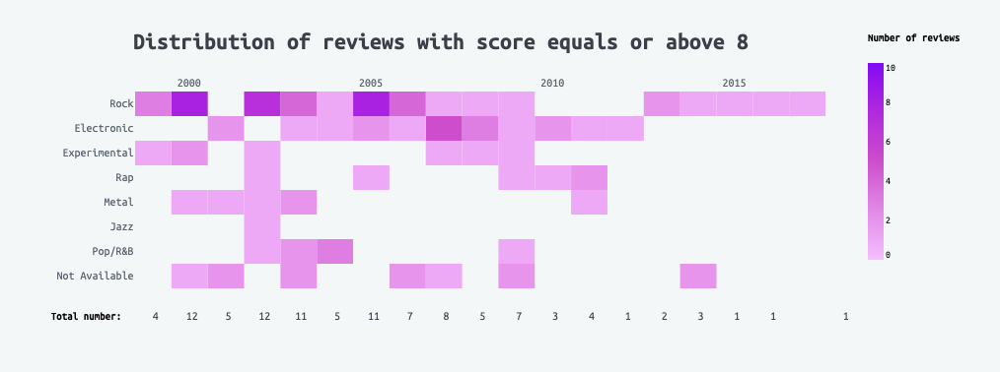

In [16]:

# axes
df.fillna('Not Available', inplace = True)
a = ['Rock', 'Electronic', 'Experimental', 'Rap', 'Metal', 'Folk/Country', 'Jazz', 'Global', 'Pop/R&B', 'Not Available']

axisY = alt.Axis(grid=False, 
                 domain=False, 
                 ticks=False,
                 labelAngle = 0,
                 labelColor = text_color,
                 labelFontSize = text_size,
                 labelFont = font,
                 )

# axes
axisX = alt.Axis(values = [2000,2005,2010,2015,2019],
                grid=False, 
                 domain=False, 
                 ticks=False,
                 labelAngle =0,
                 labelColor = text_color,
                 labelFontSize = text_size,
                 labelFont = font,
                 labelPadding = -200-15
                 )

color_scale = ['#7e0cf5', '#cd4dcc', '#f7beff']
color_scale.reverse()
domain = [0, 5, 10]
range_ = color_scale


a = alt.Chart(df).mark_rect().encode(
    x = alt.X('date:N', timeUnit='year', axis = axisX, title = None),
    y = alt.Y('primary:N', axis = axisY, sort = a, title = None),
    color = alt.Color('count()',  scale=alt.Scale(domain=domain, range=range_), legend = alt.Legend(title = 'Number of reviews',
                                                                                                    titleFont = font, 
                                                                                                    labelFont = font,
                                                                                                   titlePadding = 20, clipHeight = 50)),
    tooltip = alt.Tooltip(['mean(score)', 'count()'])
).properties(width = 700, height = 200).transform_filter(
    'datum.score<=2')

# Total labeling
axisX = alt.Axis(labels = False,
                 grid=False, 
                 domain=False, 
                 ticks=False,
                 titleX = -50,
                 titleY = -11,
                 titleFont = font
                 )
total = alt.Chart(df).mark_text(dx = -16, fontWeight = 300, fontSize = 12, font=font, color = title_color).encode(
    x = alt.X('date:T', timeUnit='year', title = 'Total number:', axis = axisX, scale=alt.Scale(domain=(1998,2017))),
    text =  alt.Y('count()', title = None)
).properties(width = 700, height = 10).transform_filter(
    'datum.score <=2')

# Stacking
b = title&a&total
b.configure(background=background, text = alt.TextConfig(font=font),
                padding={"left": 50, "top": 30, "right": 40, "bottom": 50}
).configure_view(
    stroke='transparent'
)

**I don't really like this type of visualization in case we have not a lot records. So, I decided to make one more.**

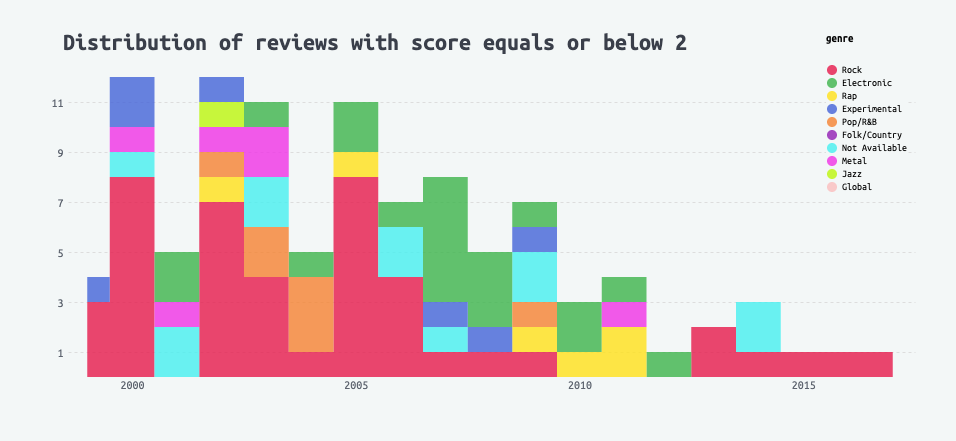

In [8]:
# title
title_text = 'Distribution of reviews with score equals or below 2'
text_df_footer = pd.DataFrame({'text':[title_text]})
title = alt.Chart(text_df_footer).mark_text(fontWeight = 600, fontSize=24, font=font, color = title_color,align = 'center' ,dx = 10).encode(
    text='text').properties(width=600, height=20)

axisY = alt.Axis(values = [i for i in range(1,13)],
                 grid=True,
                 gridDash = [0,3,0],
                 domain=False, 
                 ticks=False,
                 labelAngle = 0,
                 labelColor = text_color,
                 labelFontSize = text_size,
                 labelFont = font,
                 )

# axes
axisX = alt.Axis(values = [2000,2005,2010,2015,2019],
                grid=False, 
                 domain=False, 
                 ticks=False,
                 labelAngle =0,
                 labelColor = text_color,
                 labelFontSize = text_size,
                 labelFont = font,
                 )
domain = list(df.primary.unique())
color_palette = ['#e6194b', '#3cb44b', '#ffe119', '#4363d8', '#f58231', '#911eb4', '#46f0f0', '#f032e6', '#bcf60c', '#fabebe'] 
range_ = color_palette
# Stacked area chart - number of records by genre, by year
a = alt.Chart(df).mark_area(interpolate='step', opacity = 0.8).encode(
    x = alt.X('date:N', timeUnit='year', title='', axis = axisX),
    y = alt.Y('count()', title = None, axis = axisY),
        color = alt.Color('primary',  scale=alt.Scale(domain=domain, range=range_), legend = alt.Legend(title = 'genre',
                                                                                                    titleFont = font, 
                                                                                                    labelFont = font,
                                                                                                   titlePadding = 20,
                                                                                                        offset = -90, 
                                                                                                        fillColor = background)),
    tooltip = alt.Tooltip(['count()', 'primary'])
).properties(width = 850).transform_filter(
    'datum.score<=2')

b=title&a

# Stacking
b.configure(background=background, text = alt.TextConfig(font=font),
                padding={"left": 50, "top": 30, "right": 40, "bottom": 50}
).configure_view(
    stroke='transparent'
)

## Genre's rank (by number of reviews) and it's number of reviews by year

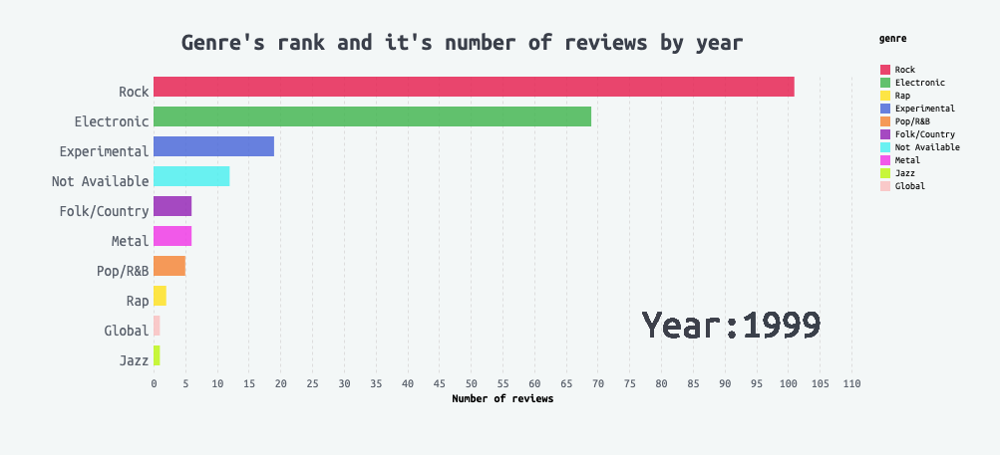

In [17]:
# title
title_text = "Genre's rank and it's number of reviews by year"
text_df_footer = pd.DataFrame({'text':[title_text]})
title = alt.Chart(text_df_footer).mark_text(fontWeight = 600, fontSize=24, font=font, color = title_color,align = 'center' ,dx = 10).encode(
    text='text').properties(width=600, height=20)

# axes
axisY = alt.Axis(
                 grid=False,
                 domain=False, 
                 ticks=False,
                 labelAngle = 0,
                 labelColor = text_color,
                 labelFontSize = text_size+3,
                 labelFont = font,
                    labelPadding = 5
                 )
axisX = alt.Axis(
                grid=True, 
                gridDash = [0,3,0],
                 domain=False, 
                 ticks=False,
                 labelAngle =0,
                 labelColor = text_color,
                 labelFontSize = text_size,
                 labelFont = font,
                 titleFontSize = text_size,
                 titleFont = font,
                 )

domain = list(df.primary.unique())
color_palette = ['#e6194b', '#3cb44b', '#ffe119', '#4363d8', '#f58231', '#911eb4', '#46f0f0', '#f032e6', '#bcf60c', '#fabebe'] 
range_ = color_palette

slider = alt.binding_range(min=1999, max=2018, step=1, name='Year:  ', )

slider_selection = alt.selection_single(name="year_selector", fields=['year'],bind=slider, init={'year': 1999}, )

a = alt.Chart(df).mark_rect(height = 20, opacity = 0.8).encode(
    y = alt.Y('primary:N',axis = axisY,title = None, sort=alt.EncodingSortField(
            field="primary",  # The field to use for the sort
            op="count",  # The operation to run on the field prior to sorting
            order="descending"  # The order to sort in
        )),
    x = alt.X('count()', title='Number of reviews', axis = axisX),
    color = alt.Color('primary',  scale=alt.Scale(domain=domain, range=range_), legend = alt.Legend(title = 'genre',
                                                                                                    titleFont = font, 
                                                                                                    labelFont = font,
                                                                                                   titlePadding = 20)),
).transform_calculate(year = 'year(datum.date)'
).add_selection(slider_selection
).transform_filter(slider_selection
).properties(width = 700, height = 300)

# adding label
df['text'] = 'Year: '

text = alt.Chart(df).mark_text(fontWeight = 300, fontSize=40, font=font, color = title_color, opacity = 0.3, dx = 280, dy = 100).encode(
    text = "year:N", opacity=alt.value(0.5)                                                                                         
).properties(width = 700, height = 300).transform_calculate(year = 'year(datum.date)').transform_filter(slider_selection)
text2 = alt.Chart(df).mark_text(fontSize=40, font=font, color = title_color, opacity = 0.3, dx = 200, dy = 100).encode(
    text = "text:N"
).properties(width = 700, height = 300)

label = text + text2



# Stacking
a = title&(a + label)
a.configure(background=background, text = alt.TextConfig(font=font),
                padding={"left": 50, "top": 30, "right": 40, "bottom": 50}
).configure_view(
    stroke='transparent'
)